In [1]:
from dendrocat import RadioSource, MasterCatalog
from astropy.io import fits
from spectral_cube import SpectralCube
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm
import numpy as np
import sys
import importlib
from astropy.wcs import WCS
from regions import Regions, PixCoord
from astropy import stats
from itertools import chain
import dendrocat
from scipy import stats
import Paths.Paths as paths
Path = paths.filepaths()









In [2]:
from astropy.nddata.utils import Cutout2D, NoOverlapError
from astropy import coordinates, wcs
import astropy.units as u
from matplotlib import colors
from matplotlib.patches import Rectangle, Ellipse
from radio_beam import Beam
import matplotlib.patches as patches
from matplotlib.gridspec import GridSpec

def get_cutout(image_dir, xpos, ypos, fwhm):
    fitsdata = fits.open(image_dir)
    wcs_image = WCS(fitsdata[0].header,naxis=2)
    image = fitsdata[0].data[0][0]
    if len(image.shape)>2:
        image = fitsdata[0].data[0][0]
    x_cen = xpos * u.deg
    y_cen = ypos * u.deg
    position = coordinates.SkyCoord(x_cen, y_cen,
                                    frame=wcs.utils.wcs_to_celestial_frame(wcs_image).name,
                                    unit=(u.deg, u.deg))
    pixel_scale = (np.abs(wcs_image.pixel_scale_matrix.diagonal().prod())**0.5 * u.deg)
    size = 10*fwhm
        #size = 24*pixel_scale + 2.5*fwhm * u.deg
    
    cutout = Cutout2D(image,
                          position,
                      size,
                      wcs=wcs_image,
                      mode='partial')
     

  
    return cutout

def add_scale_bar(ax, xpos,ypos,scale, pixel_scale, dist, unit='pc',height=20,color='w',pad=40,size=40):
    phy_pix_scale = pixel_scale.value * np.pi/180 * dist
    ax.add_patch(Rectangle((xpos,ypos),scale/phy_pix_scale,height,color=color))
    ax.text(xpos+0.4*scale/phy_pix_scale, ypos+pad, '%2.1f %s'%(scale, unit), color=color,fontsize=size)
                
def add_beam(ax,xpos,ypos,beam, pixel_scale,color='w'):
    width = beam.major / pixel_scale
    height = beam.minor /pixel_scale
    angle = beam.pa
    ax.add_patch(Ellipse((xpos,ypos),width.value,height.value,180-angle.value,color=color))

def plot_cutouts(ax, image_dir, xpos, ypos, fwhm, cmap='inferno', 
                 addbeam=True, scale=None, dist=None, 
                 vmin=-0.00010907209521789237, vmax=0.01065474459299, sqrtpower=True,
                label=None, mmlabel=None, nomatch=False,fontcolor='w',
                ):
    
    cutout = get_cutout(image_dir, xpos, ypos, fwhm)
    shape = cutout.data.shape
    hdr = fits.getheader(image_dir)  
    wcs = WCS(hdr,naxis=2)
    pixel_scale = wcs.proj_plane_pixel_scales()[0]
    beam = Beam.from_fits_header(hdr)
    midpoint = int(shape[0]/2)

    beamsize_pix = beam.major.to(u.deg).value / pixel_scale

    if sqrtpower:
        vmax = np.nanmax(cutout.data[midpoint-int(2*beamsize_pix.value):midpoint+int(2*beamsize_pix.value), midpoint-int(2*beamsize_pix.value):midpoint+int(2*beamsize_pix.value)])
        ax.imshow(cutout.data, origin='lower', cmap=plt.get_cmap(cmap), 
              norm=colors.PowerNorm(gamma=0.5, vmin=np.min(cutout.data[np.isfinite(cutout.data)]), 
                                    vmax=1.5*vmax),aspect='equal')
    else:
        
        ax.imshow(cutout.data, origin='lower', cmap=plt.get_cmap(cmap), 
              vmin=vmin, vmax=vmax,aspect='auto')
    if addbeam:
        add_beam(ax, 0.15*shape[0], 0.15*shape[1], beam, pixel_scale)
    if scale is not None:
        add_scale_bar(ax, 0.8*shape[0], 0.2*shape[1], scale, pixel_scale, dist)
    if label is not None:
        ax.text(0.08*shape[0],0.85*shape[1], label, color=fontcolor, fontsize=35)
   
        
    #if mmlabel is not None:
    #    ax.text(0.65*shape[0],0.85*shape[1], mmlabel, color=mmlabelcolor, fontsize=25)
    ax.set_xticks([])
    ax.set_yticks([])
    return cutout.data


def plot_set_cutouts(table_fin, b3file, b6file, savedir='', 
startnum=0,  nrow=9, ncol=4, margin = 0.01, top = 0.98, bottom = 0.02,
wspace=0.00, hspace=0.00, additional_row=0, endnum=None):
    
    hdr_b3 = fits.getheader(b3file)
    hdr_b6 = fits.getheader(b6file)

    beam_b3 = Beam.from_fits_header(hdr_b3)    
    beam_b6 = Beam.from_fits_header(hdr_b6)

    if endnum is None:
        endnum = len(table_fin['b3_xsky'])
    endendnum = len(table_fin['b3_xsky'])

    width = (1 - margin*ncol)/ncol
    height = (top-bottom-5*margin)/(nrow+additional_row)
    ratio = width/2/height
    bottom = top - height * nrow
    figsize=40
    fig = plt.figure(figsize=(figsize,figsize*ratio))

    for icol in range(ncol):
        gs = GridSpec(nrow, 2, left=(icol+1)*margin+icol*width, right=(icol+1)*(margin+width), 
                      wspace=wspace, hspace=hspace, top=top, bottom=bottom)
        for irow in range(nrow):
            obsnum = icol * nrow + irow + startnum
            print('obsnum',obsnum)
            if obsnum > endnum:
                continue
            obsnum_final = obsnum
            ax1 = fig.add_subplot(gs[irow,0])
            ax2 = fig.add_subplot(gs[irow,1])
            ax1.set_aspect('auto')
            ax2.set_aspect('auto')
            ax1.xaxis.set_major_locator(plt.NullLocator())
            ax1.yaxis.set_major_locator(plt.NullLocator())
            ax2.xaxis.set_major_locator(plt.NullLocator())
            ax2.yaxis.set_major_locator(plt.NullLocator())

            if irow == 0:
                ax1.set_title('3 mm', fontsize=40)
                ax2.set_title('1.3 mm', fontsize=40)

            xpos_b3 = table_fin['b3_xsky'][obsnum]
            ypos_b3 = table_fin['b3_ysky'][obsnum]
            #fwhm_b3 = table_fin['b3_afwhm'][obsnum]
            
            xpos_b6 = table_fin['b6_xsky'][obsnum]
            ypos_b6 = table_fin['b6_ysky'][obsnum]
            #fwhm_b6 = table_fin['b6_afwhm'][obsnum]
            
            isoverlap = table_fin['is_overlap'][obsnum]
            
            b3id = table_fin['b3_id'][obsnum]
            b6id = table_fin['b6_id'][obsnum]
            b3continue=True ; b6continue=True
            nomatch_b3 = False ; nomatch_b6 = False
            print(obsnum, xpos_b3, ypos_b3, xpos_b6, ypos_b6, b3id, b6id)

            if not isoverlap: # if B3 positions are out of the FoV of B6, then just skip drawing
                if xpos_b3 < 0 or ypos_b3 <0:
                    b3continue=False
                if xpos_b6 < 0 or ypos_b6 <0:
                    b6continue=False
            else:
                if xpos_b3 < 0 or ypos_b3 <0:
                    xpos_b3 = xpos_b6 ; ypos_b3 = ypos_b6
                    nomatch_b3=True
                if xpos_b6 < 0 or ypos_b6 <0:
                    xpos_b6 = xpos_b3 ; ypos_b6 = ypos_b3
                    nomatch_b6=True
            size = (beam_b3.major+beam_b6.major)/2   
            if b3continue:
                b3arr = plot_cutouts(ax1, b3file, xpos_b3, ypos_b3, size,label='#%d'%(obsnum), mmlabel='3 mm', nomatch=nomatch_b3)
                
            if b6continue:
                b6arr = plot_cutouts(ax2, b6file, xpos_b6, ypos_b6, size, mmlabel='1.3 mm',nomatch=nomatch_b6)
            if nomatch_b3:
                rect = patches.Rectangle((0.02*b3arr.shape[1], 0.02*b3arr.shape[0]), 0.96*b3arr.shape[1], 0.96*b3arr.shape[0], linewidth=30, edgecolor='cyan', facecolor='none')
                ax1.add_patch(rect)

            if nomatch_b6:
                rect = patches.Rectangle((0.02*b6arr.shape[1], 0.02*b6arr.shape[0]), 0.96*b6arr.shape[1], 0.96*b6arr.shape[0], linewidth=30, edgecolor='cyan', facecolor='none')
                ax2.add_patch(rect)
    print('obsnum_final, endnum',obsnum_final, endnum)
    print('endnum',endnum)   
    if additional_row > 0:
        top_add = bottom - 5*margin
        bottom_add = top_add - additional_row * height
        print('height',height)
        print('top_add', top_add)
        print('bottom_add', bottom_add)
        gs_add = GridSpec(additional_row, ncol*2, left=margin, right=1-margin,wspace=0.0, hspace=0.0, top=top_add, bottom=bottom_add)
        arr = np.arange(endnum+1, endendnum)
        for num in arr:
            ind = num - endnum - 1

            xind = ind % (ncol*2) 
            yind = ind // (ncol*2)
            print('ind, xind, yind', ind, xind, yind)
            ax = fig.add_subplot(gs_add[yind,xind])
            if ind==0:
                ax.set_title('3 mm', fontsize=40)
            #ax.set_aspect('auto')
            ax.xaxis.set_major_locator(plt.NullLocator())
            ax.yaxis.set_major_locator(plt.NullLocator())
            xpos_b3 = table_fin['b3_xsky'][num]
            ypos_b3 = table_fin['b3_ysky'][num]
            b3arr = plot_cutouts(ax, b3file, xpos_b3, ypos_b3, size,label='#%d'%(num), mmlabel='3 mm', nomatch=nomatch_b3)
                



    print('plot saved to ', savedir)
    plt.savefig(savedir)
    

             
def plot_set_cutouts_single(table_fin, b3file, b6file, savedir='', 
startnum=0,  nrow=9, ncol=4, margin = 0.01, top = 0.98, bottom = 0.02,
wspace=0.00, hspace=0.00, endnum=None, different_font_color_ind=[]):

    hdr_b3 = fits.getheader(b3file)
    hdr_b6 = fits.getheader(b6file)

    beam_b3 = Beam.from_fits_header(hdr_b3)    
    beam_b6 = Beam.from_fits_header(hdr_b6)

    if endnum is None:
        endnum = len(table_fin['b3_xsky'])

    width = (1 - margin*ncol)/ncol
    height = (top-bottom)/nrow
    ratio = width/height
    figsize=40
    fig = plt.figure(figsize=(figsize,figsize*ratio))

    gs = GridSpec(nrow, ncol, left=margin, right=1-margin, 
                    wspace=wspace, hspace=hspace, top=top, bottom=bottom)
    
    for irow in range(nrow):
        for icol in range(ncol):
            obsnum = irow * ncol + icol + startnum
            print('obsnum',obsnum)
            #print(obsnum, xpos_b3, ypos_b3,  b3id)


            ax1 = fig.add_subplot(gs[irow,icol])
            #ax2 = fig.add_subplot(gs[irow,icol])
            ax1.set_aspect('auto')
            #ax2.set_aspect('auto')

            ax1.xaxis.set_major_locator(plt.NullLocator())
            ax1.yaxis.set_major_locator(plt.NullLocator())

            if obsnum > endnum:
                continue

           
           


            if irow == 0 and icol == 0:
                ax1.set_title('3 mm', fontsize=40)
            #    ax2.set_title('1.3 mm', fontsize=40)

            xpos_b3 = table_fin['b3_xsky'][obsnum]
            ypos_b3 = table_fin['b3_ysky'][obsnum]
            #fwhm_b3 = table_fin['b3_afwhm'][obsnum]
            
            #xpos_b6 = table_fin['b6_xsky'][obsnum]
            #ypos_b6 = table_fin['b6_ysky'][obsnum]
            #fwhm_b6 = table_fin['b6_afwhm'][obsnum]
            
            isoverlap = table_fin['is_overlap'][obsnum]
            
            b3id = table_fin['b3_id'][obsnum]
            #b6id = table_fin['b6_id'][obsnum]
            b3continue=True ; b6continue=True
            nomatch_b3 = False ; nomatch_b6 = False

            if not isoverlap: # if B3 positions are out of the FoV of B6, then just skip drawing
                if xpos_b3 < 0 or ypos_b3 <0:
                    b3continue=False
            #      if xpos_b6 < 0 or ypos_b6 <0:
            #          b6continue=False
            else:
                if xpos_b3 < 0 or ypos_b3 <0:
                    xpos_b3 = xpos_b6 ; ypos_b3 = ypos_b6
                    nomatch_b3=True
            #      if xpos_b6 < 0 or ypos_b6 <0:
            #          xpos_b6 = xpos_b3 ; ypos_b6 = ypos_b3
            #          nomatch_b6=True
            size = (beam_b3.major+beam_b6.major)/2   
            if b3continue:
                if obsnum in different_font_color_ind:
                    fontcolor = 'k'
                else:
                    fontcolor = 'w'
                b3arr = plot_cutouts(ax1, b3file, xpos_b3, ypos_b3, size,label='#%d'%(obsnum), mmlabel='3 mm', nomatch=nomatch_b3, fontcolor=fontcolor)
                
            #if b6continue:
            #    b6arr = plot_cutouts(ax2, w51e_b6_calibrated_pbcor, xpos_b6, ypos_b6, size, mmlabel='1.3 mm',nomatch=nomatch_b6)
            if nomatch_b3:
                rect = patches.Rectangle((0.02*b3arr.shape[1], 0.02*b3arr.shape[0]), 0.96*b3arr.shape[1], 0.96*b3arr.shape[0], linewidth=30, edgecolor='cyan', facecolor='none')
                ax1.add_patch(rect)

            #if nomatch_b6:
            #    rect = patches.Rectangle((0.05*b6arr.shape[1], 0.05*b6arr.shape[1]), 0.9*b6arr.shape[1], 0.9*b6arr.shape[0], linewidth=30, edgecolor='r', facecolor='none')
            #    ax2.add_patch(rect)
    plt.savefig(savedir)       
    plt.show()     


132
obsnum 0
0 290.9323236580427 14.505409165819163 290.93232480562904 14.50541222136782 930000 2260000
obsnum 1
1 290.9295792256517 14.511508551611088 290.92958280761815 14.511510946414232 93008614 226000162
obsnum 2
2 290.9324542082429 14.505457777245084 290.932455642757 14.505459999460392 930002 2260003
obsnum 3
3 290.9323698526286 14.505461665938908 290.932371860991 14.505463332600574 930003 2260004
obsnum 4
4 290.9324642504769 14.50550249948864 290.9324648242204 14.505504443924297 930004 2260006
obsnum 5
5 290.93224934308944 14.505939998942365 290.9322524991548 14.505941110052976 930008 2260013
obsnum 6
6 290.932584757782 14.505932221933161 290.9325841838294 14.505934444144511 930009 2260016
obsnum 7
7 290.93261086786623 14.50595749975086 290.93261287623363 14.505959999743824 930010 2260017
obsnum 8
8 290.93127523365786 14.50606249401039 290.9312758073839 14.506065549560057 930011 2260020
obsnum 9
9 290.9323598082871 14.506204443693052 290.93236152972986 14.506206665909666 930014 

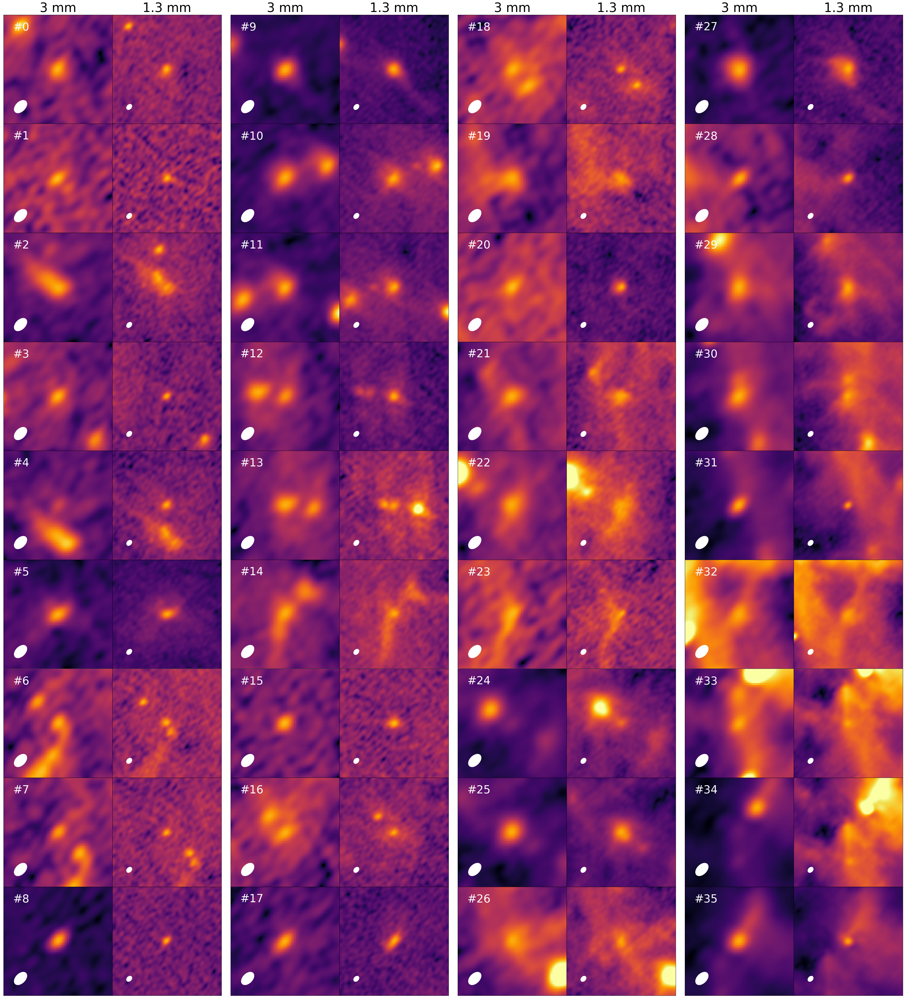

In [3]:
from astropy.table import Table
table_w51e = Table.read(Path.w51e_dendro_matched_catalog)
print(len(table_w51e))
    


plot_set_cutouts(table_w51e, Path.w51e_b3_tt0, Path.w51e_b6_cont,nrow=9,savedir='w51e_snapshot-1.png')


obsnum 36
36 290.93283581557955 14.507894166643528 290.9328378239677 14.507895555523456 930116 2260351
obsnum 37
37 290.93203040705674 14.508965553741877 290.9320355716581 14.508967775974341 930123 2260387
obsnum 38
38 290.93345242405894 14.508969443936586 290.933455293244 14.50896999947614 930124 2260390
obsnum 39
39 290.9333017870279 14.50920472198142 290.93330150000054 14.509205555305178 930126 2260511
obsnum 40
40 290.93388626101455 14.50926888707522 290.93388913020686 14.509269998165058 930129 2260548
obsnum 41
41 290.93365930048736 14.509307776746626 290.93364811016716 14.509308887880692 930133 2260553
obsnum 42
42 290.9331873028754 14.509581944342363 290.9331924675019 14.509583333216197 930201 2260748
obsnum 43
43 290.9329764099399 14.509611111119309 290.93298128763655 14.509612222220008 930195 2260752
obsnum 44
44 290.93242206256986 14.509671388289053 290.93242464482876 14.50967333272936 930215 2260787
obsnum 45
45 290.93306880121185 14.509747222205275 290.9330719573353 14.5097

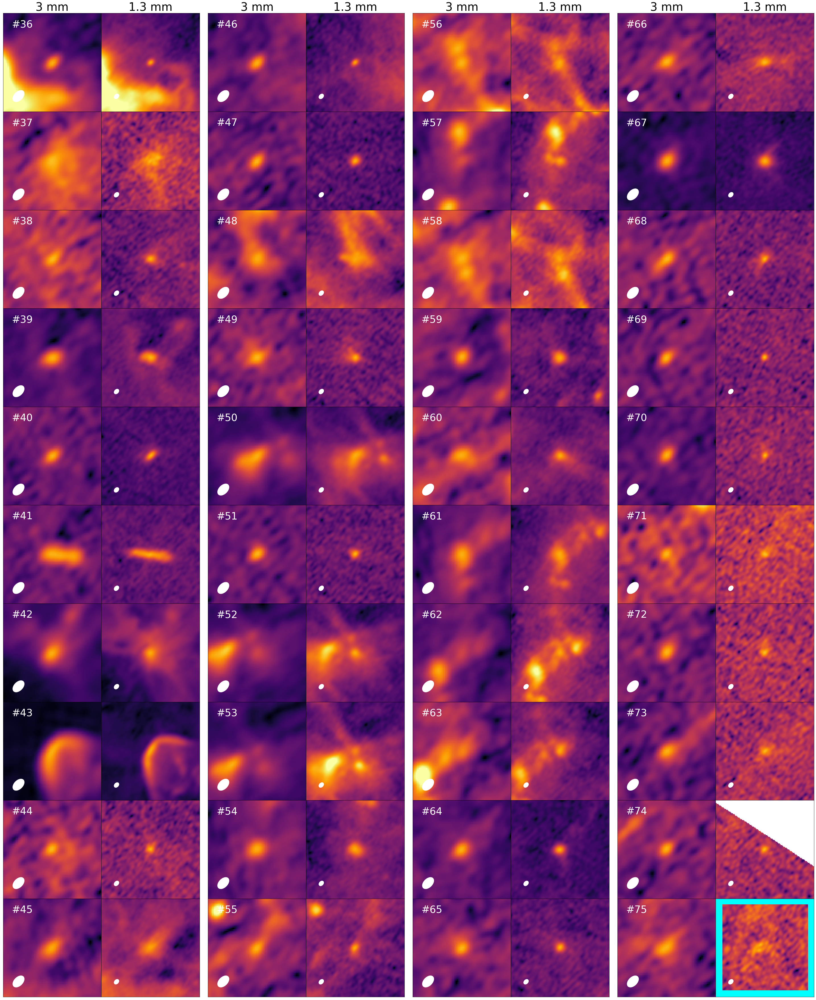

In [4]:
plot_set_cutouts(table_w51e, Path.w51e_b3_tt0,  Path.w51e_b6_cont,startnum=36, nrow=10,savedir='w51e_snapshot-2.png')


obsnum 76
76 290.9326048425858 14.505873888630619 -1.0 -1.0 930007 --
obsnum 77
77 290.93264501059616 14.506863610911164 -1.0 -1.0 930030 --
obsnum 78
78 290.9326028322829 14.507015277518263 -1.0 -1.0 930034 --
obsnum 79
79 290.93331182623484 14.507139721965851 -1.0 -1.0 930044 --
obsnum 80
80 290.93296636736534 14.508166388897484 -1.0 -1.0 930120 --
obsnum 81
81 290.93231360702663 14.5083919435734 -1.0 -1.0 930121 --
obsnum 82
82 290.93352272116846 14.508835277112416 -1.0 -1.0 930122 --
obsnum 83
83 290.9324923587054 14.51040249954933 -1.0 -1.0 930312 --
obsnum 84
84 290.92857703414677 14.508436312925866 -1.0 -1.0 93009892 --
obsnum 85
85 290.92856499846226 14.507666312701886 -1.0 -1.0 93036732 --
obsnum 86
86 -1.0 -1.0 290.9324659719925 14.50546999948216 -- 2260005
obsnum 87
87 -1.0 -1.0 290.93257959305737 14.505923333026077 -- 2260015
obsnum 88
88 -1.0 -1.0 290.9324544932972 14.506235555015186 -- 2260034
obsnum 89
89 -1.0 -1.0 290.9326186138913 14.506502221975301 -- 2260079
obsnum 9

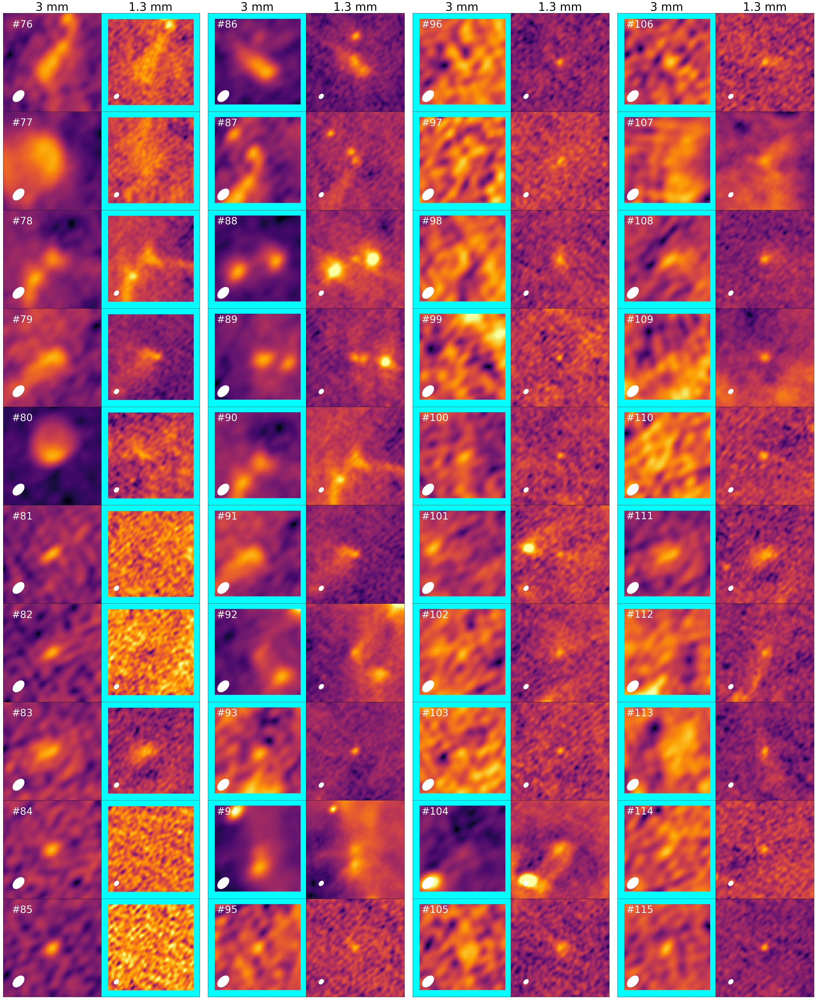

In [5]:
plot_set_cutouts(table_w51e, Path.w51e_b3_tt0, Path.w51e_b6_cont,startnum=76, nrow=10,savedir='w51e_snapshot-3.png')


obsnum 116
116 -1.0 -1.0 290.93246710288474 14.51304333282353 -- 2261007
obsnum 117
obsnum 118
obsnum 119
obsnum_final, endnum 116 116
endnum 116
height 0.29
top_add 0.5999999999999999
bottom_add 0.019999999999999907
ind, xind, yind 0 0 0
ind, xind, yind 1 1 0
ind, xind, yind 2 2 0
ind, xind, yind 3 3 0
ind, xind, yind 4 4 0
ind, xind, yind 5 5 0
ind, xind, yind 6 6 0
ind, xind, yind 7 7 0
ind, xind, yind 8 0 1
ind, xind, yind 9 1 1
ind, xind, yind 10 2 1
ind, xind, yind 11 3 1
ind, xind, yind 12 4 1
ind, xind, yind 13 5 1
ind, xind, yind 14 6 1
plot saved to  w51e_snapshot-4.png


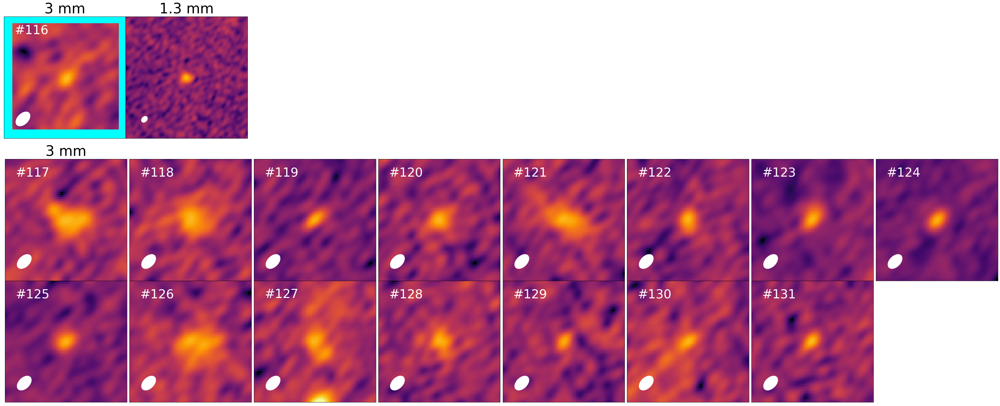

In [6]:
plot_set_cutouts(table_w51e, Path.w51e_b3_tt0, Path.w51e_b6_cont,startnum=116, ncol=4,nrow=1, endnum=116, additional_row =2,savedir='w51e_snapshot-4.png',top=0.94)


obsnum 116


NameError: name 'xpos_b6' is not defined

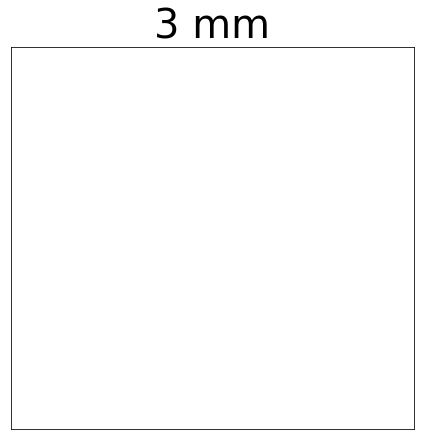

In [7]:
plot_set_cutouts_single(table_w51e, Path.w51e_b3_tt0, Path.w51e_b6_cont,startnum=116, nrow=3, ncol=7, savedir='w51e_snapshot-4.png',top = 0.94)


71
obsnum 0
0 290.9146520640484 14.517598602530239 290.9146540877684 14.517602211771774 9311874 2260047
obsnum 1
1 290.9149573660281 14.517820271604664 290.91496053732016 14.517822214455654 9311903 2260050
obsnum 2
2 290.91711257137194 14.517894166260028 290.9171148817953 14.51789666654037 9311911 2260051
obsnum 3
3 290.9159074232162 14.518008887682536 290.9159051424691 14.518013331336828 9311941 2260067
obsnum 4
4 290.9155097237706 14.518100274957531 290.9155103123461 14.518102218273638 9311968 2260089
obsnum 5
5 290.91618259850935 14.518125555073759 290.91618519565134 14.518126665654504 9311983 2260098
obsnum 6
6 290.9159556287268 14.518141110054858 290.915956791138 14.518145553765578 9311980 2260100
obsnum 7
7 290.91586725127314 14.51810027643882 290.9158661182054 14.518103331173297 9311978 2260101
obsnum 8
8 290.9156342557767 14.518109997757158 290.91563541821677 14.51811333007475 9311984 2260107
obsnum 9
9 290.91647986858015 14.518150833273886 290.9164824656977 14.518153333002575 

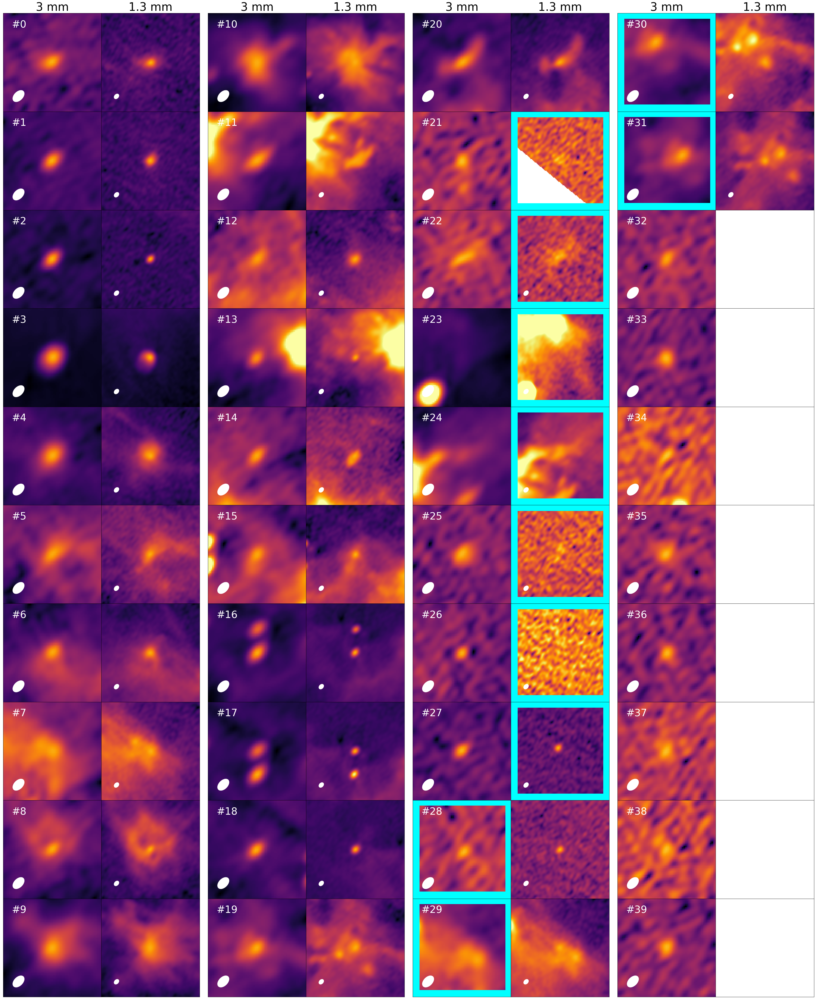

In [ ]:
table_w51n = Table.read(Path.w51n_dendro_matched_catalog)
print(len(table_w51n))
hdr_b3 = fits.getheader(Path.w51n_b3_tt0)
hdr_b6 = fits.getheader(Path.w51n_b6_cont)

beam_b3 = Beam.from_fits_header(hdr_b3)    
beam_b6 = Beam.from_fits_header(hdr_b6)    


plot_set_cutouts(table_w51n, Path.w51n_b3_tt0, Path.w51n_b6_cont, nrow=10, ncol=4,savedir='w51n_snapshot-1.png')


obsnum 40
40 290.91114525057 14.511111879876974 -1.0 -1.0 937566 --
obsnum 41
41 290.9117719060974 14.511207171479423 -1.0 -1.0 937643 --
obsnum 42
42 290.9103579048407 14.511345193485441 -1.0 -1.0 937738 --
obsnum 43
43 290.91085601335317 14.511516317382753 -1.0 -1.0 937910 --
obsnum 44
44 290.9107375089045 14.511578536659004 -1.0 -1.0 937954 --
obsnum 45
45 290.91070537155287 14.511615480294415 -1.0 -1.0 937976 --
obsnum 46
46 290.9117277059697 14.511776892784997 -1.0 -1.0 938112 --
obsnum 47
47 290.9120048788135 14.51194217619951 -1.0 -1.0 938231 --
obsnum 48
48 290.91117734866936 14.512651880634904 -1.0 -1.0 938552 --
obsnum 49
49 290.91119944156117 14.512690770036622 -1.0 -1.0 938575 --
obsnum 50
50 290.91142840136814 14.513235219674446 -1.0 -1.0 938750 --
obsnum 51
51 290.9203945189405 14.513649415023327 -1.0 -1.0 938857 --
obsnum 52
52 290.9238934322395 14.514712944962657 -1.0 -1.0 939426 --
obsnum 53
53 290.92431924513147 14.514716820433447 -1.0 -1.0 939566 --
obsnum 54
54 290.

IndexError: index 71 is out of bounds for axis 0 with size 71

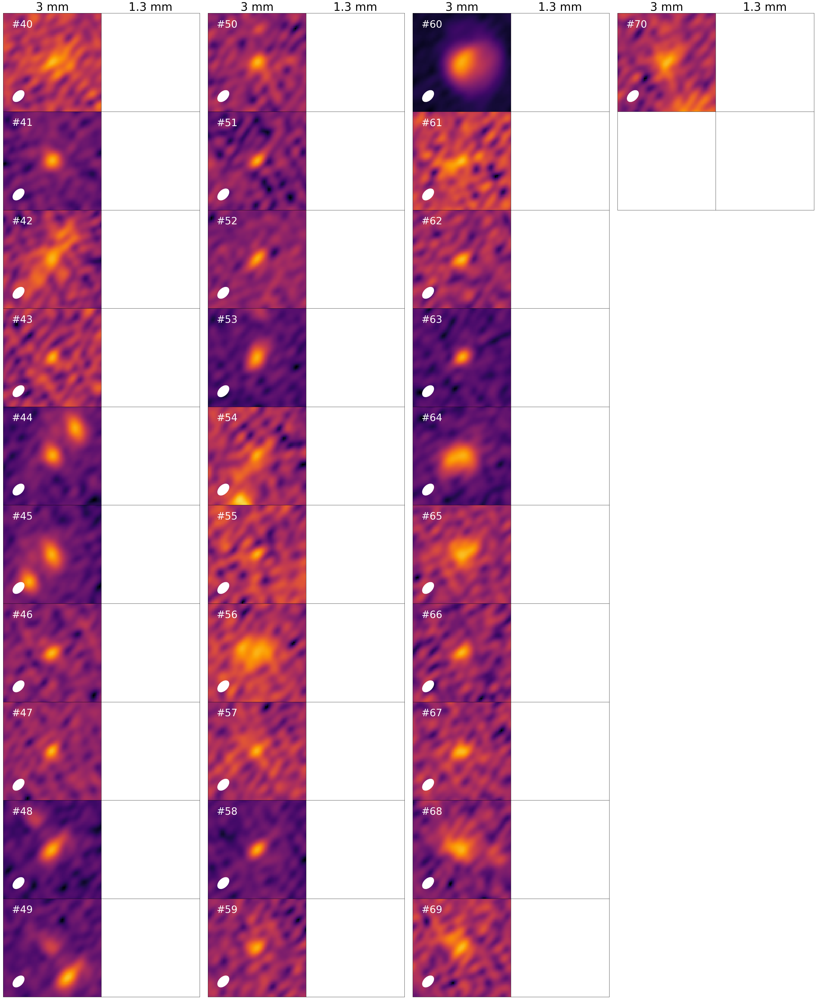

In [ ]:
plot_set_cutouts(table_w51n, Path.w51n_b3_tt0, Path.w51n_b6_cont,startnum=40, nrow=10, ncol=4, endnum=73,savedir='w51n_snapshot-2.png',top = 0.94)


obsnum 40
obsnum 41
obsnum 42
obsnum 43
obsnum 44
obsnum 45
obsnum 46
obsnum 47
obsnum 48
obsnum 49
obsnum 50
obsnum 51
obsnum 52
obsnum 53
obsnum 54
obsnum 55
obsnum 56
obsnum 57
obsnum 58
obsnum 59
obsnum 60
obsnum 61
obsnum 62
obsnum 63
obsnum 64
obsnum 65
obsnum 66
obsnum 67
obsnum 68
obsnum 69
obsnum 70
obsnum 71


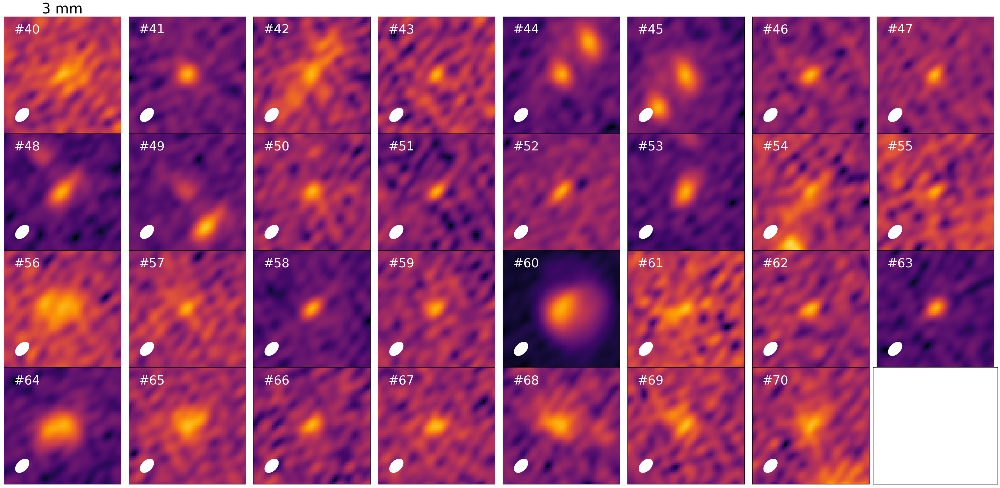

In [ ]:
plot_set_cutouts_single(table_w51n, Path.w51n_b3_tt0, Path.w51n_b6_cont,startnum=40, nrow=4, ncol=8, 
savedir='w51n_snapshot-2.png',top = 0.94, endnum=70, )
